In [1]:
using Distributions
using LinearAlgebra
using Turing
using ForwardDiff
using ReverseDiff
using MCMCChains
using StatsBase
using StatsPlots
using StatsModels
using Statistics
using Random
using Base.Iterators
using Plots
using DataFrames
using Quadrature
using GBIF
using Rasters
using Suppressor

### Reconstructing a Grid-Based Probability Distribution

We will now move up from our one dimensional problem and analyze a two-dimensional grid-based distribution. We first create our data. The probability is modeled as such:
<br>
<br>
$\text{logit}(x, y) = \text{hinge}_x - \text{hinge}_x*x + y$
<br>
<br>
$p(x, y) = \text{logistic}(\text{logit}(x, y)) \Delta{X} \Delta{Y}$
<br>
<br>
$\text{presence}(x, y) \sim \text{Bernoulli}(p(x, y))$
<br>
<br>
We are assuming the values of the features are constant throughout the grid pixel and so the total probability of presence is the probability density(given by the logistic function) times the area of the pixel. The below conglomeration of functions result in a dataframe of all pixels in the grid along with if there was a presence there and what the features were.


In [4]:
#A function to create a grid of points from -l to l with n pixels between
function create_grid(n::Int64, lx::Float64, ly::Float64)
    a = range(-lx, lx, n)
    b = range(-ly, ly, n)
    return collect(product(a, b))
end;

#A function to create a hinge feature out of the x-coordinate
function create_hinge_feature(point, offset)
    y = point[1] - offset
    if y > 0.0
        return y
    else
        return 0.0
    end
end;

#A function to return the y coordinate
function y_feature(point)
    return point[2]
end;

#A function to return the x coordinate
function x_feature(point)
    return point[1]
end;

#The definition of a logistic function used to create a probability
function logistic(x)
    return 1.0/(1.0 + exp(-x))
end;

#Creation of feature grids
function create_features(specified_grid)
    hinge_feature = create_hinge_feature.(specified_grid, 0.0)
    x_linear_feature = x_feature.(specified_grid);
    y_linear_feature = y_feature.(specified_grid);
    linear_hinge_interaction = hinge_feature .* x_linear_feature;

    return x_linear_feature, y_linear_feature, hinge_feature, linear_hinge_interaction
end;

#Create a probability distribution from the hinge feature, the y-linear feature 	#and the interaction between the y
function create_presence_features(specified_grid, dx, dy)
    x_linear_feature, y_linear_feature, hinge_feature, linear_hinge_interaction = create_features(specified_grid)
    logit = hinge_feature - linear_hinge_interaction + y_linear_feature
    prob = logistic.(logit)*dx*dy
    presences = rand.(Bernoulli.(prob))

    return prob, presences, x_linear_feature, y_linear_feature, hinge_feature
end;

In [5]:
n_points = 50;
lx = 20.0;
ly = 20.0;
dx = 2.0*lx/n_points;
dy = 2.0*ly/n_points;

grid_of_points = create_grid(n_points, lx, ly);

prob,
presences,
x_linear_feature,
y_linear_feature,
hinge_feature = create_presence_features(grid_of_points, dx, dy);

The plots below show the probability and the random boolean (presence) which resulted from the grid of probabilities.

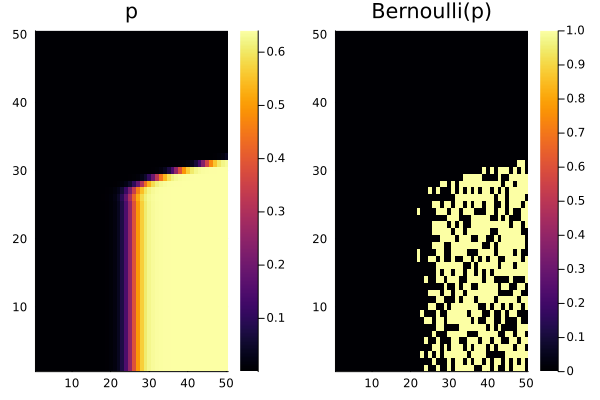

In [6]:
plot([heatmap(prob, title="p"), heatmap(presences, title="Bernoulli(p)")]...)

We now place all features into a dataframe and take out the observed presence sample. The full dataframe over all pixels is what is traditionally called the background sample.


In [8]:
function create_dataframe(x_linear_feature,
                          y_linear_feature,
                          hinge_feature,
                          presences)
    df = DataFrame()
    df[!, :x_linear] = vcat(x_linear_feature...)
    df[!, :y_linear] = vcat(y_linear_feature...)
    df[!, :hinge] = vcat(hinge_feature...)
    df[!, :presence] = vcat(presences...)

    return df
end

dataframe = create_dataframe(x_linear_feature, y_linear_feature, hinge_feature, presences);
presences_df = dataframe[dataframe[!, :presence] .== 1, Not(:presence)];
non_presences_df = dataframe[dataframe[!, :presence] .== 0, Not(:presence)];
background_df = dataframe[!, Not(:presence)];

Quickly looking at the first five entries into the presence dataframe:

In [9]:
first(presences_df, 5)

Row,x_linear,y_linear,hinge
,Float64,Float64,Float64
1,-6.93878,-2.85714,0.0
2,-6.12245,-2.85714,0.0
3,-1.22449,-2.85714,0.0
4,-18.3673,-2.04082,0.0
5,-13.4694,-2.04082,0.0


We next write down our inference function. Since the function values are the same throughout the pixel, our integration is actually simpler for the partition function:

$Z = \int_{(x, y) \in \mathbb{R}^{2}} e^{\sum_{i}\beta_{i}f(x, y)} dxdy = \sum^{\text{All Pixels}}_{j} e^{\sum_{i}\beta_{i}f(x_j, y_j)} \Delta{x} \Delta{y}$

but other than that one change, it is identical the the normal distribution example.

In [13]:
function beta_matrix(v)
    n = length(v)
    s = Int(round((sqrt(8*n+1)-1)/2))
    return [ i<=j ? v[Int(j*(j-1)/2+i)] : 0 for i=1:s, j=1:s ]
end;

@model function ℓπ_grid(presences, background)

	num_features = size(presences)[2]

	#The number of lagrange multipliers needed to cover the square of the features and the interactions between features
	d_interactions = Int(num_features*(num_features+1)/2)

	#The total number of lagrange multipliers needed
    d_total = num_features + d_interactions

	#The priors on the lagrange multipliers will be Laplace which is equivalent to L1 normalization
    β ~ filldist(Laplace(0.0, 0.5), d_total)

	#Splitting the lagrange multipliers into the linear and non-linear terms
	linear_β = β[1:num_features]
    interacting_β = β[num_features+1:end]
    interacting_β_matrix = beta_matrix(interacting_β)

	#The first portion of the log-posterior is the sum over presence samples
	log_post = 0.0
	@inbounds for i in 1:size(presences)[1]
    	x = presences[i, :]
        log_post += dot(linear_β, x') + dot(interacting_β_matrix * x, x')
    end

	Z = 0.0
	@inbounds for i in 1:size(background)[1]
		x = background[i, :]
		Z += exp(dot(linear_β, x') + dot(interacting_β_matrix*x, x'))
	end

	#Add to the log posterior the partition function portion
    log_post += -size(presences)[1]*log(Z)

	Turing.@addlogprob! log_post
end;

Sampling...

In [14]:
ℓπ1 = ℓπ_grid(Matrix(presences_df), Matrix(background_df));
grid_chain = sample(ℓπ1,
                    NUTS(1000, 0.65),
                    MCMCThreads(),
                    2000,
                    2; discard_adapt=true);

┌ Warning: Only a single thread available: MCMC chains are not sampled in parallel
└ @ AbstractMCMC ~/.julia/packages/AbstractMCMC/fWWW0/src/sample.jl:296
┌ Info: Found initial step size
└   ϵ = 0.00625
┌ Info: Found initial step size
└   ϵ = 0.003125


Once again checking to see that the sampling converged:

In [15]:
gelmandiag(grid_chain)

Gelman, Rubin, and Brooks diagnostic
  parameters      psrf    psrfci 
      Symbol   Float64   Float64 

        β[1]    1.0033    1.0039
        β[2]    1.0010    1.0029
        β[3]    1.0034    1.0055
        β[4]    1.0008    1.0009
        β[5]    1.0005    1.0007
        β[6]    1.0020    1.0068
        β[7]    1.0044    1.0144
        β[8]    1.0002    1.0013
        β[9]    1.0037    1.0130


How about the autocorrelation?

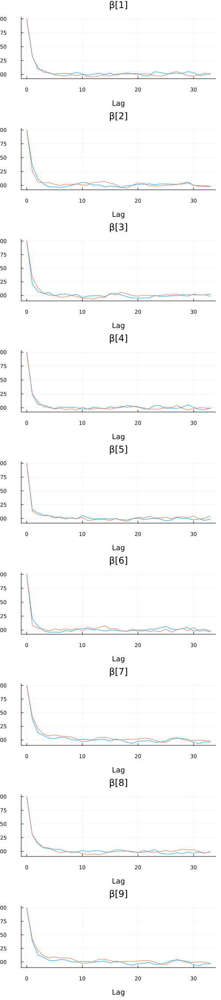

In [16]:
autocorplot(grid_chain)

We see high correlation at small lags so let's sparsify the samples a bit by taking every fifth sample:Ω

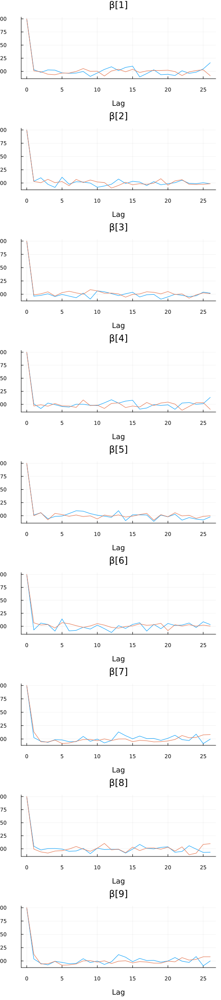

In [20]:
grid_chain_sparse = grid_chain[1:5:end, :, :]
autocorplot(grid_chain_sparse)

Looking good! Let's plot the chains now:

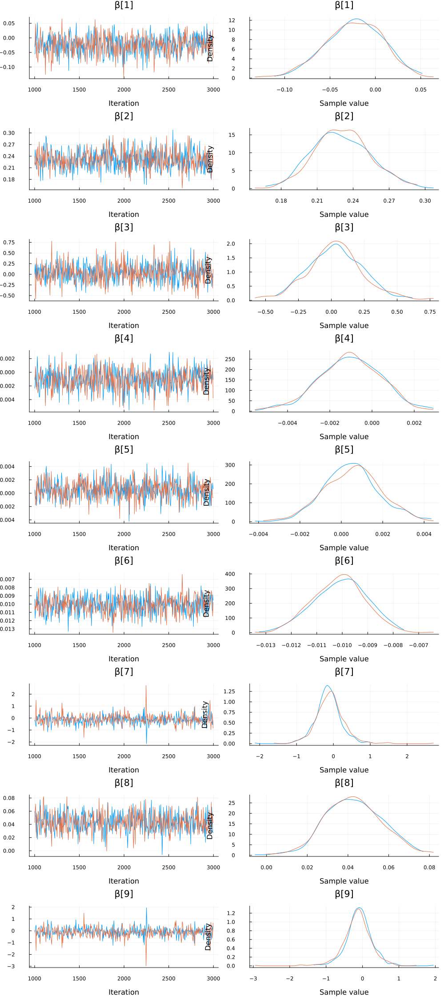

In [21]:
plot(grid_chain_sparse)

and finally predicting. Here we show the original probability distribution, the mean of the posterior along with the median and standard deviation(error)

In [23]:
function predict(β, samples_to_predict, background)
    predictions = zeros(size(samples_to_predict)[1])

    n = size(samples_to_predict)[2]

    d_interactions = Int(n*(n+1)/2)
    d_total = n + d_interactions

    linear_β = β[1:n]
    interacting_β = β[n+1:end]
    interacting_β_matrix = beta_matrix(interacting_β)

	Z = 0.0
	@inbounds for i in 1:size(background)[1]
    	x = background[i, :]
        Z += exp(dot(linear_β, x') + dot(interacting_β_matrix*x, x'))
    end

    @inbounds for i in 1:size(samples_to_predict)[1]
        x = samples_to_predict[i, :]
        predictions[i] = dot(linear_β, x') + dot(interacting_β_matrix*x, x')
    end


    return exp.(predictions) ./ Z
end;

In [24]:
β_matrix_grid = Matrix(DataFrame(grid_chain_sparse));
predictions_array_grid = zeros(Float64, size(β_matrix_grid)[1], size(prob)[1], size(prob)[2]);

for i in 1:size(β_matrix_grid)[1]
    β_grid = β_matrix_grid[i, 3:11]
    a = predict(β_grid, Matrix(background_df), Matrix(background_df));
    predictions_array_grid[i, :, :] = reshape(a, size(prob))
end

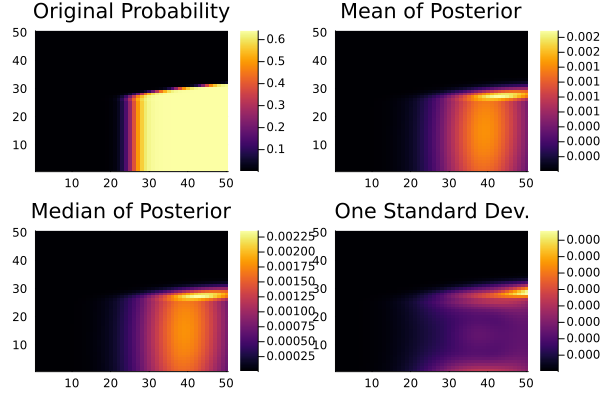

In [25]:
list_of_heatmaps = [heatmap(prob, title="Original Probability"),
						heatmap(mean(predictions_array_grid, dims=1)[1,:,:],
						title="Mean of Posterior"),
						heatmap(median(predictions_array_grid, dims=1)[1,:,:],
						title="Median of Posterior"),
						heatmap(std(predictions_array_grid, dims=1)[1,:,:],
						title="One Standard Dev.")]
plot(list_of_heatmaps...)

and a histogram of predictions:

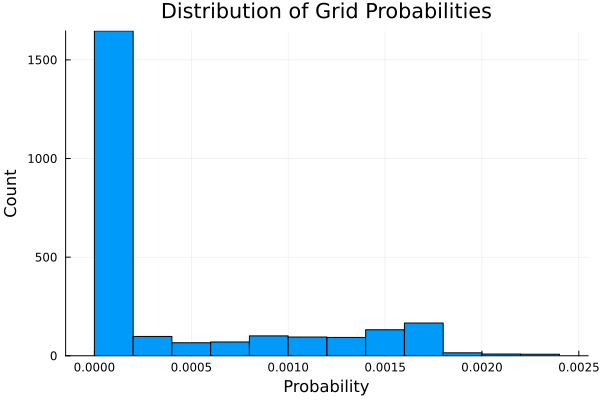

In [26]:
histogram(vcat(mean(predictions_array_grid, dims=1)[1,:,:]...), ylabel="Count", xlabel="Probability", title="Distribution of Grid Probabilities", label="")

Visually, it looks about correct, but why such low probabilities? Well remember that like the first normal distribution sample, all probabilities throughout the space must sum to one. In this case, the space is a two dimensional grid. Confirming that all probabilities sum to one:

In [28]:
sum(vcat(mean(predictions_array_grid, dims=1)[1,:,:]...))

1.0000000000000002

Unlike the original problem where each pixel had an absolute probability of being a presence, maximum entropy predicts a "relative" probalility over all the space. This does not prevent us from conducting the usual ML metric such as ROC-AUC:


In [29]:
function roc_auc(scores, classes, num_thresholds)
	tpr = zeros(num_thresholds+1)
	fpr = zeros(num_thresholds+1)

	min_score = minimum(scores)
	max_score = maximum(scores)

	d_threshold = (max_score-min_score)/num_thresholds

	for i in 1:num_thresholds+1
		thresh = min_score + (i-1)*d_threshold
		decisions = 1 .* (scores .>= thresh)
		tp = sum((decisions .== 1) .& (classes .== 1))
		tn = sum((decisions .== 0) .& (classes .== 0))
		fp = sum((decisions .== 1) .& (classes .== 0))
		fn = sum((decisions .== 0) .& (classes .== 1))
		tpr[i] = tp/(tp+fn)
		fpr[i] = fp/(fp+tn)
	end
	tpr = reverse(tpr)
	fpr = reverse(fpr)

	auc = 0.0
	for i in 2:num_thresholds+1
		auc += 0.5*(tpr[i]+tpr[i-1])*(fpr[i]-fpr[i-1])
	end

	return tpr, fpr, auc
end;

In [30]:
labels = dataframe[!, :presence]
β_ = β_matrix_grid[1, 3:11]
scores = predict(β_, Matrix(background_df), Matrix(background_df));
tpr, fpr, auc = roc_auc(scores, labels, 2000)
p = plot(fpr, tpr, label="", title="ROC Curves", xlabel="FPR", ylabel="TPR", alpha=0.01, linecolor=:red)
auc_vector = zeros(size(β_matrix_grid)[1])
auc_vector[1] = auc

for i in 2:size(β_matrix_grid)[1]
    scores_ = predict(β_matrix_grid[i, 3:11], Matrix(background_df), Matrix(background_df));
    tpr, fpr, auc = roc_auc(scores_, labels, 2000)
    auc_vector[i] = auc
    plot!(fpr, tpr, label="", alpha=0.01, linecolor=:red)
end

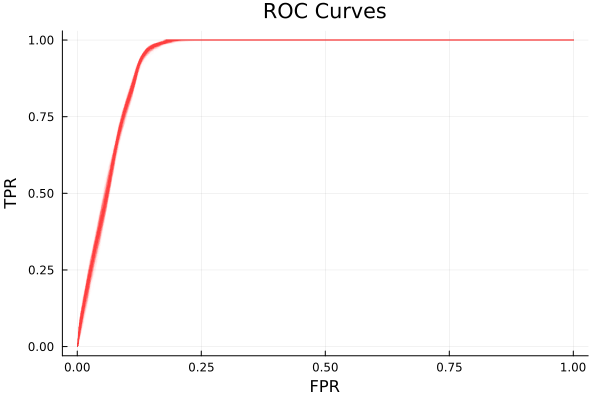

In [31]:
plot(p)

Due to the lagrange multipliers being random variables, there are multiple predictions for the ROC curve and too with the ROC-AUC values:


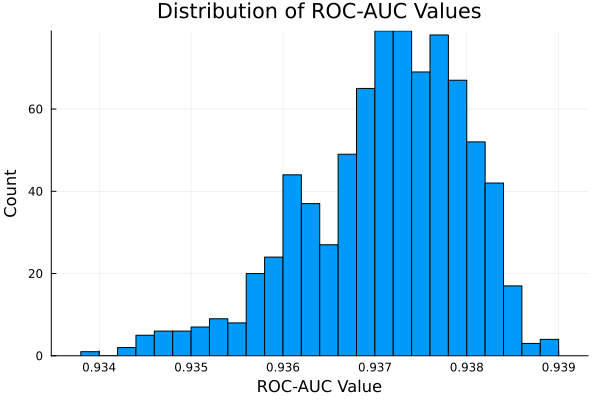

In [32]:
histogram(auc_vector, title="Distribution of ROC-AUC Values", label="", xlabel="ROC-AUC Value", ylabel="Count", bins = 30)


In practice, usually information on non-presence is unknown so these metrics cannot be truly known, only approximated, but here, since we are looking at fake-data, we can calculate them. We want ROC-AUC values to be as close to one as possible, which we achieve.
